# **Tema 1 IA - Tunaru Ștefania Emilia, 331CB**

Acest notebook conține:


**I. Implementarea euristicilor și a algoritmilor**
1. Import-uri necesare
2. Funcțiile euristice
3. Algoritmul IDA*
4. Algoritmul Simulated Annealing
5. Încărcarea hărților pentru testare
6. Funcția pentru rularea algoritmilor

**II. Graficele rezultate în urma analizei individuale**

**III. Graficele rezultate în urma analizei comparative**

**IV. Vizualizarea evoluției algoritmilor**

## I. Implementarea euristicilor și a algoritmilor

### 1. Import-uri necesare

In [1]:
from sokoban import Map
import time
import math
import numpy as np
import random
np.random.seed(0)
import pandas as pd
import matplotlib.pyplot as plt
from sokoban.gif import save_images, create_gif
from IPython.display import Image, display
import os

### 2. Funcțiile euristice

In [2]:
def euclidean_distance(a, b):
    return math.hypot(b[0] - a[0], b[1] - a[1])

def manhattan_distance(a, b):
    return abs(b[0] - a[0]) + abs(b[1] - a[1])

def ponderated_euclidean_heuristic(state, weight=2) -> float:
    boxes = list(state.positions_of_boxes.keys())
    targets = list(state.targets)
    total = 0
    used_targets = set()
    
    for box in boxes:
        min_dist = float('inf')
        min_target = None
        for target in targets:
            if target in used_targets:
                continue
            dist = euclidean_distance(box, target)
            if dist < min_dist:
                min_dist = dist
                min_target = target
        if min_target is not None:
            used_targets.add(min_target)
        total += min_dist
    
    player = (state.player.x, state.player.y)
    min_player_box = min(euclidean_distance(player, box) for box in boxes)
    
    return weight * total + min_player_box

def ponderated_manhattan_heuristic(state, weight=2) -> int:
    boxes = list(state.positions_of_boxes.keys())
    targets = list(state.targets)
    total = 0
    used_targets = set()
    
    for box in boxes:
        min_dist = float('inf')
        min_target = None
        for target in targets:
            if target in used_targets:
                continue
            dist = manhattan_distance(box, target)
            if dist < min_dist:
                min_dist = dist
                min_target = target
        if min_target is not None:
            used_targets.add(min_target)
        total += min_dist
    
    player = (state.player.x, state.player.y)
    min_player_box = min(manhattan_distance(player, box) for box in boxes)
    
    return weight * total + min_player_box

### 3. Algoritmul IDA*

In [3]:
def ida_star(map_obj, heuristic):
    def create_state_tuple(node):
        player_pos = (node.player.x, node.player.y)
        box_positions = tuple(sorted(node.positions_of_boxes.keys()))
        return (player_pos, box_positions)

    def next_nodes(node):
        moves = node.filter_possible_moves()
        neighbours = node.get_neighbours()
        return [(neighbours[i], moves[i]) for i in range(len(moves))]

    def search(node, g, threshold, path, visited_states):
        f = g + heuristic(node)
        if f > threshold:
            return False, f, []
        if node.is_solved():
            return True, 0, path
        current_state = create_state_tuple(node)
        if current_state in visited_states and g >= visited_states[current_state]:
            return False, float('inf'), []
        visited_states[current_state] = g
        min_f = float('inf')
        min_path = []
        for next_state, move in next_nodes(node):
            found, new_f, temp_path = search(next_state, g + 1, threshold, path + [move], visited_states)
            if found:
                return True, new_f, temp_path
            if new_f < min_f:
                min_f = new_f
                min_path = temp_path
        return False, min_f, min_path
    threshold = heuristic(map_obj)
    while True:
        visited_states = {}
        found, new_threshold, path = search(map_obj, 0, threshold, [], visited_states)
        if found:
            return path
        if new_threshold == float('inf'):
            return []
        threshold = new_threshold


### 4. Algoritmul Simulated Annealing

In [4]:
def simulated_annealing(map_obj, heuristic, initial_temperature=10000, final_temperature=0.01, cooling_rate=0.999, alpha=0.97, max_iters=100000, num_restarts=20):
    def softmax(x):
        x = np.array(x)
        e_x = np.exp(x - np.max(x))
        return e_x / e_x.sum()

    def next_nodes(node):
        moves = node.filter_possible_moves()
        neighbours = []
        for move in moves:
            new_map = node.copy()
            new_map.apply_move(move)
            neighbours.append((new_map, move))
        return neighbours

    best_path = []
    best_length = float('inf')
    random.seed(0)
    for _ in range(num_restarts):
        current_state = map_obj.copy()
        current_cost = heuristic(current_state)
        best_state = current_state.copy()
        best_cost = current_cost
        best_path_local = []
        path = []
        temperature = initial_temperature
        iters = 0
        while temperature > final_temperature and iters < max_iters:
            if current_state.is_solved():
                break
            neighbours = next_nodes(current_state)
            if not neighbours:
                break
            neighbour_states = [n[0] for n in neighbours]
            moves = [n[1] for n in neighbours]
            costs = [heuristic(state) for state in neighbour_states]
            probs = softmax(-np.array(costs) / (temperature * alpha))
            idx = np.random.choice(len(neighbours), p=probs)
            next_state = neighbour_states[idx]
            next_move = moves[idx]
            next_cost = costs[idx]
            delta = current_cost - next_cost
            if delta > 0:
                current_state = next_state
                current_cost = next_cost
                path.append(next_move)
                if current_cost < best_cost:
                    best_state = current_state.copy()
                    best_cost = current_cost
                    best_path_local = path.copy()
            else:
                acceptance_probability = np.exp(delta / (temperature * alpha))
                if np.random.rand() < acceptance_probability:
                    current_state = next_state
                    current_cost = next_cost
                    path.append(next_move)
            if iters % 100 == 0 and current_cost > best_cost:
                current_state = best_state.copy()
                current_cost = best_cost
                path = best_path_local.copy()
            temperature *= cooling_rate
            iters += 1
        if best_state.is_solved() and best_path_local and len(best_path_local) < best_length:
            best_path = best_path_local
            best_length = len(best_path_local)
        elif current_state.is_solved() and path and len(path) < best_length:
            best_path = path
            best_length = len(path)
    return best_path

### 5. Încărcarea hărților pentru testare

In [5]:
test_maps = [
    "tests/easy_map1.yaml",
    "tests/easy_map2.yaml",
    "tests/medium_map1.yaml",
    "tests/medium_map2.yaml",
    "tests/large_map1.yaml",
    "tests/large_map2.yaml",
    "tests/hard_map1.yaml",
    "tests/hard_map2.yaml",
    "tests/super_hard_map1.yaml"
]

### 6. Funcție pentru rularea algoritmilor pe testele de input

In [6]:
def run_algorithm_on_tests(solver_func, test_maps, heuristic):
    def count_pull_moves(solution, current_map):
        pull_moves = 0
        temp_map = current_map.copy()
        for move in solution or []:
            before_undo = temp_map.undo_moves
            temp_map.apply_move(move)
            after_undo = temp_map.undo_moves
            if after_undo > before_undo:
                pull_moves += 1
        return pull_moves

    results = []
    for map_path in test_maps:
        map_name = map_path.split('/')[-1].replace('.yaml', '')
        m = Map.from_yaml(map_path)
        start = time.time()
        solution = solver_func(m, heuristic)
        duration = time.time() - start
        if hasattr(m, "explored_states"):
            temp_map = m.copy()
            for move in solution or []:
                temp_map.apply_move(move)
            states_built = temp_map.explored_states
        else:
            states_built = len(solution) + 1 if solution else 1

        pull_moves = count_pull_moves(solution, m)
        found = solution is not None and len(solution) > 0
        results.append({
            'Hartă': map_name,
            'Algoritm': solver_func.__name__,
            'Număr mișcări de pull': pull_moves,
            'Stări construite': states_built,
            'Timp (secunde)': duration
        })
    return results

print("Rezultatele rulării algoritmilor:")
ida_results = run_algorithm_on_tests(ida_star, test_maps, ponderated_manhattan_heuristic)
sa_results = run_algorithm_on_tests(simulated_annealing, test_maps, ponderated_manhattan_heuristic)
df = pd.DataFrame(ida_results + sa_results)
display(df)

Rezultatele rulării algoritmilor:


,Hartă,Algoritm,Număr mișcări de pull,Stări construite,Timp (secunde)
0,easy_map1,ida_star,1,17,0.041721
1,easy_map2,ida_star,0,9,0.001000
2,medium_map1,ida_star,3,14,0.003965
3,medium_map2,ida_star,6,24,0.442138
4,large_map1,ida_star,3,30,0.145859
5,large_map2,ida_star,6,33,0.131958
6,hard_map1,ida_star,2,32,1.445541
7,hard_map2,ida_star,2,35,6.133054
8,super_hard_map1,ida_star,7,36,0.816249
9,easy_map1,simulated_annealing,5,85,11.932239


## II. Graficele rezultate în urma analizei individuale

### 1. Analiza timpilor de execuție - IDA* cu mișcări de pull

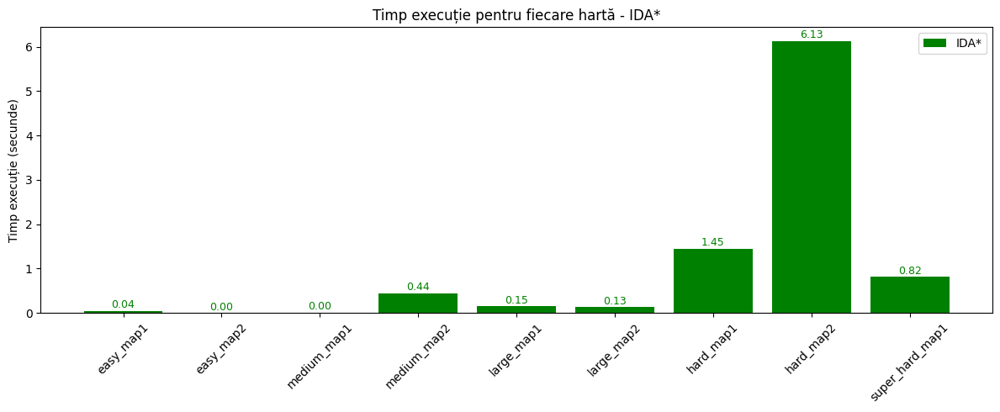

In [7]:
x = np.arange(len(test_maps))
ida_time = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    ida_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'ida_star')]
    ida_time.append(float(ida_row['Timp (secunde)'].values[0]) if not ida_row.empty else 0)
plt.figure(figsize=(12, 5))
bars = plt.bar(x, ida_time, color='green', label='IDA*')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Timp execuție (secunde)')
plt.title('Timp execuție pentru fiecare hartă - IDA*')
plt.legend()
plt.tight_layout()
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height:.2f}', ha='center', va='bottom', fontsize=9, color='green')

plt.show()

### 2. Analiza numărului de stări explorate - IDA* cu mișcări de pull

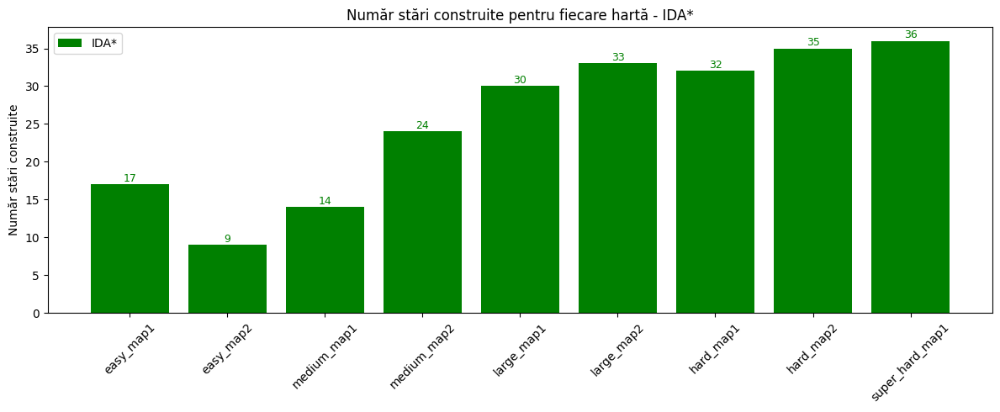

In [8]:
x = np.arange(len(test_maps))
ida_states = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    ida_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'ida_star')]
    ida_states.append(int(ida_row['Stări construite'].values[0]) if not ida_row.empty else 0)
plt.figure(figsize=(12, 5))
bars = plt.bar(x, ida_states, color='green', label='IDA*')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Număr stări construite')
plt.title('Număr stări construite pentru fiecare hartă - IDA*')
plt.legend()
plt.tight_layout()
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='green')

plt.show()

### 3. Analiza numărului de mișcări de pull - IDA* cu mișcări de pull

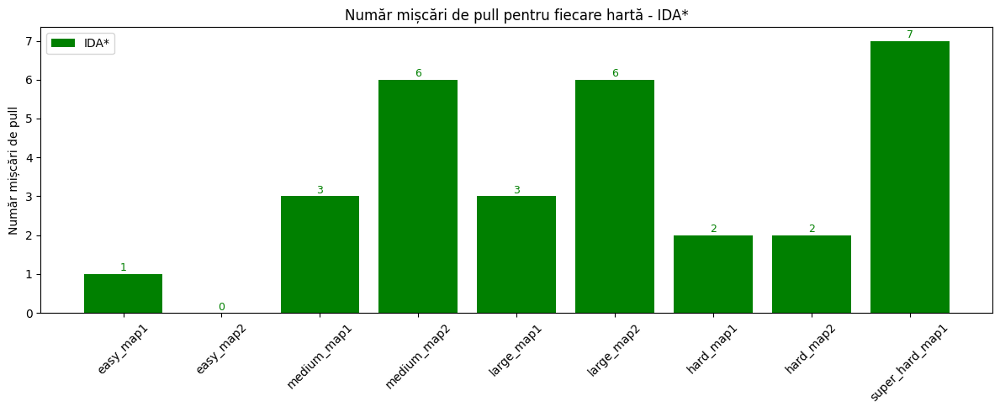

In [9]:
x = np.arange(len(test_maps))
ida_pull_moves = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    ida_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'ida_star')]
    ida_pull_moves.append(int(ida_row['Număr mișcări de pull'].values[0]) if not ida_row.empty else 0)
plt.figure(figsize=(12, 5))
bars = plt.bar(x, ida_pull_moves, color='green', label='IDA*')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Număr mișcări de pull')
plt.title('Număr mișcări de pull pentru fiecare hartă - IDA*')
plt.legend()
plt.tight_layout()
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='green')

plt.show()

### 4. Analiza timpilor de execuție - Simulated Annealing cu mișcări de pull

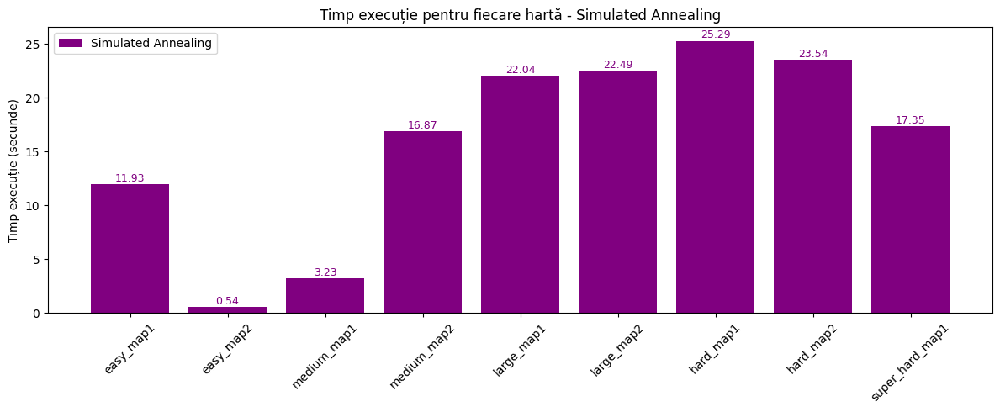

In [10]:
x = np.arange(len(test_maps))
sa_time = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    sa_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'simulated_annealing')]
    sa_time.append(float(sa_row['Timp (secunde)'].values[0]) if not sa_row.empty else 0)
plt.figure(figsize=(12, 5))
bars = plt.bar(x, sa_time, color='purple', label='Simulated Annealing')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Timp execuție (secunde)')
plt.title('Timp execuție pentru fiecare hartă - Simulated Annealing')
plt.legend()
plt.tight_layout()
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height:.2f}', ha='center', va='bottom', fontsize=9, color='purple')

plt.show()

### 5. Analiza numărului de stări explorate - Simulated Annealing cu mișcări de pull

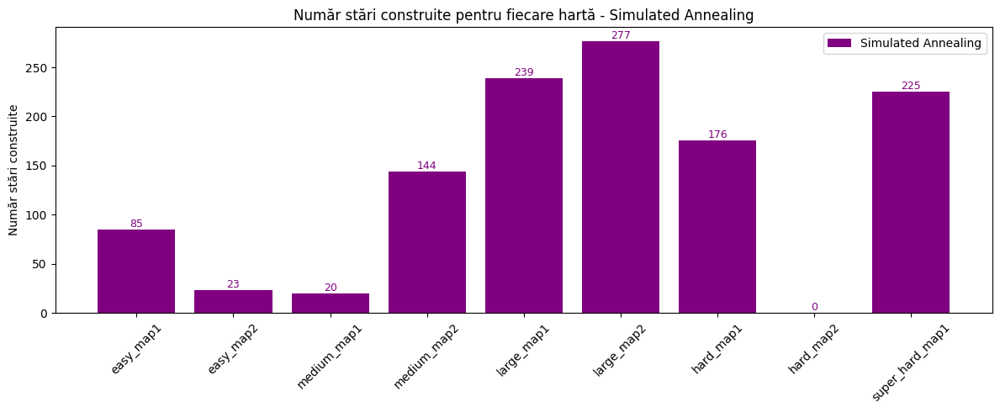

In [11]:
x = np.arange(len(test_maps))
sa_states = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    sa_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'simulated_annealing')]
    sa_states.append(int(sa_row['Stări construite'].values[0]) if not sa_row.empty else 0)
plt.figure(figsize=(12, 5))
bars = plt.bar(x, sa_states, color='purple', label='Simulated Annealing')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Număr stări construite')
plt.title('Număr stări construite pentru fiecare hartă - Simulated Annealing')
plt.legend()
plt.tight_layout()
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='purple')

plt.show()

### 6. Analiza numărului de mișcări de pull - Simulated Annealing cu mișcări de pull

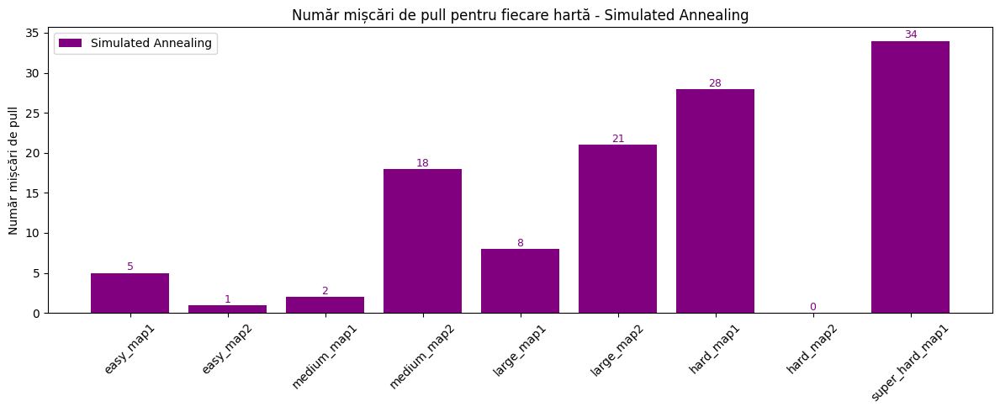

In [12]:
x = np.arange(len(test_maps))
sa_pull_moves = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    sa_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'simulated_annealing')]
    sa_pull_moves.append(int(sa_row['Număr mișcări de pull'].values[0]) if not sa_row.empty else 0)
plt.figure(figsize=(12, 5))
bars = plt.bar(x, sa_pull_moves, color='purple', label='Simulated Annealing')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Număr mișcări de pull')
plt.title('Număr mișcări de pull pentru fiecare hartă - Simulated Annealing')
plt.legend()
plt.tight_layout()
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='purple')

plt.show()

## III. Graficele rezultate în urma analizei comparative

### 1. Analiză a timpilor de execuție 

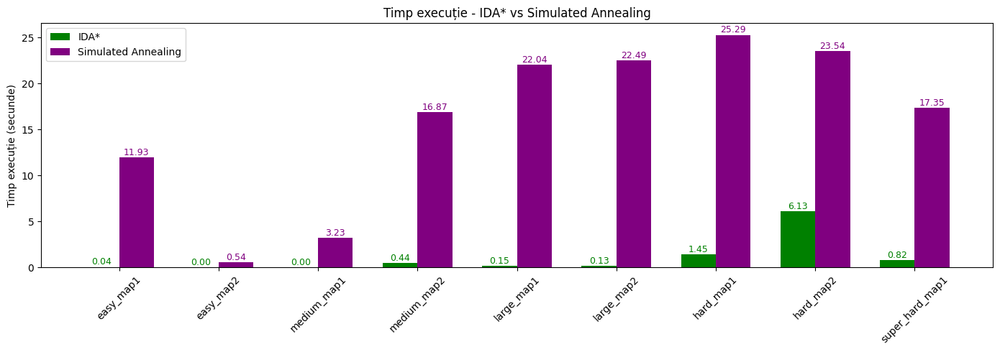

In [13]:
x = np.arange(len(test_maps))
width = 0.35

ida_time = []
sa_time = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    ida_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'ida_star')]
    sa_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'simulated_annealing')]
    ida_time.append(float(ida_row['Timp (secunde)'].values[0]) if not ida_row.empty else 0)
    sa_time.append(float(sa_row['Timp (secunde)'].values[0]) if not sa_row.empty else 0)
plt.figure(figsize=(14, 5))
bars1 = plt.bar(x - width/2, ida_time, width, label='IDA*', color='green')
bars2 = plt.bar(x + width/2, sa_time, width, label='Simulated Annealing', color='purple')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Timp execuție (secunde)')
plt.title('Timp execuție - IDA* vs Simulated Annealing')
plt.legend()
plt.tight_layout()
for bar in bars1:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height:.2f}', ha='center', va='bottom', fontsize=9, color='green')
for bar in bars2:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height:.2f}', ha='center', va='bottom', fontsize=9, color='purple')

plt.show()

### 2. Analiză a numărului de stări construite 

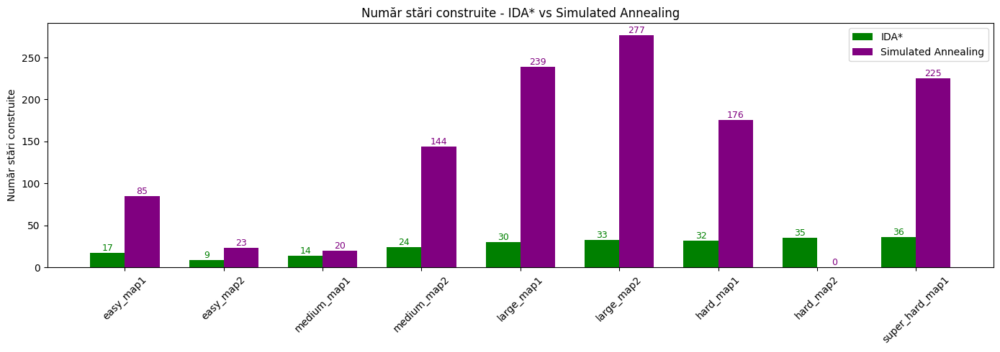

In [14]:
x = np.arange(len(test_maps))
width = 0.35

ida_states = []
sa_states = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    ida_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'ida_star')]
    sa_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'simulated_annealing')]
    ida_states.append(int(ida_row['Stări construite'].values[0]) if not ida_row.empty else 0)
    sa_states.append(int(sa_row['Stări construite'].values[0]) if not sa_row.empty else 0)
plt.figure(figsize=(14, 5))
bars1 = plt.bar(x - width/2, ida_states, width, label='IDA*', color='green')
bars2 = plt.bar(x + width/2, sa_states, width, label='Simulated Annealing', color='purple')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Număr stări construite')
plt.title('Număr stări construite - IDA* vs Simulated Annealing')
plt.legend()
plt.tight_layout()
for bar in bars1:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='green')
for bar in bars2:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='purple')

plt.show()

### 3. Analiză a numărului de mișcări de pull realizate

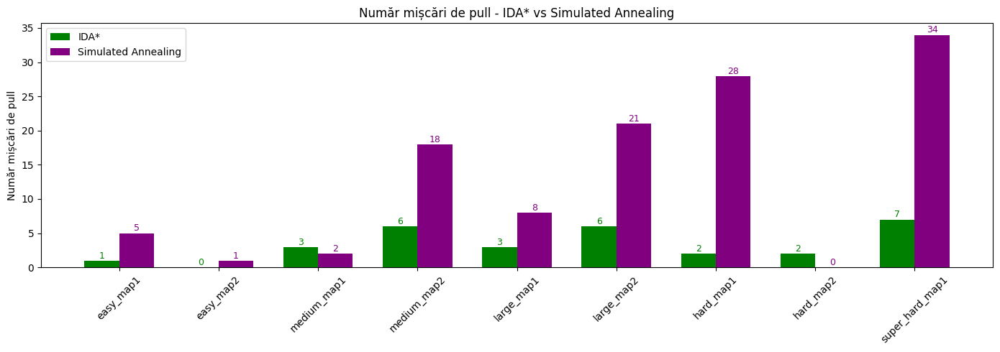

In [15]:
x = np.arange(len(test_maps))
width = 0.35

ida_pull_moves = []
sa_pull_moves = []
for name in test_maps:
    map_name = name.replace('.yaml', '').split('/')[-1]
    ida_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'ida_star')]
    sa_row = df[(df['Hartă'] == map_name) & (df['Algoritm'] == 'simulated_annealing')]
    ida_pull_moves.append(int(ida_row['Număr mișcări de pull'].values[0]) if not ida_row.empty else 0)
    sa_pull_moves.append(int(sa_row['Număr mișcări de pull'].values[0]) if not sa_row.empty else 0)
plt.figure(figsize=(14, 5))
bars1 = plt.bar(x - width/2, ida_pull_moves, width, label='IDA*', color='green')
bars2 = plt.bar(x + width/2, sa_pull_moves, width, label='Simulated Annealing', color='purple')
plt.xticks(x, [name.replace('.yaml', '').split('/')[-1] for name in test_maps], rotation=45)
plt.ylabel('Număr mișcări de pull')
plt.title('Număr mișcări de pull - IDA* vs Simulated Annealing')
plt.legend()
plt.tight_layout()
for bar in bars1:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='green')
for bar in bars2:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, height + 0.01, f'{height}', ha='center', va='bottom', fontsize=9, color='purple')

plt.show()

## IV. Vizualizarea evoluției algoritmilor

### 1. IDA*

GIF saved at: gifs/easy_map1_ida.gif


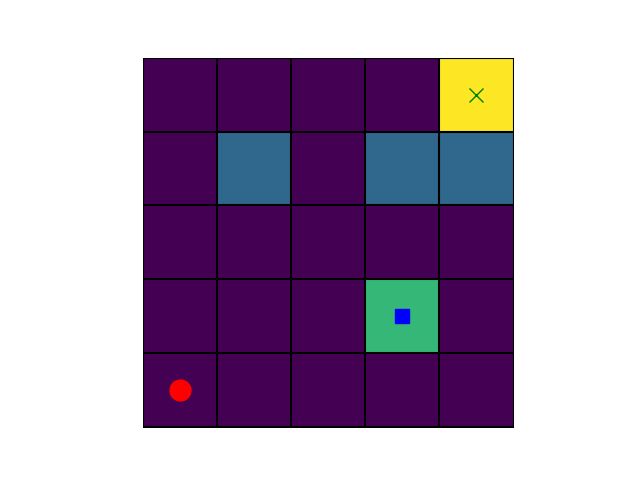

GIF saved at: gifs/easy_map2_ida.gif


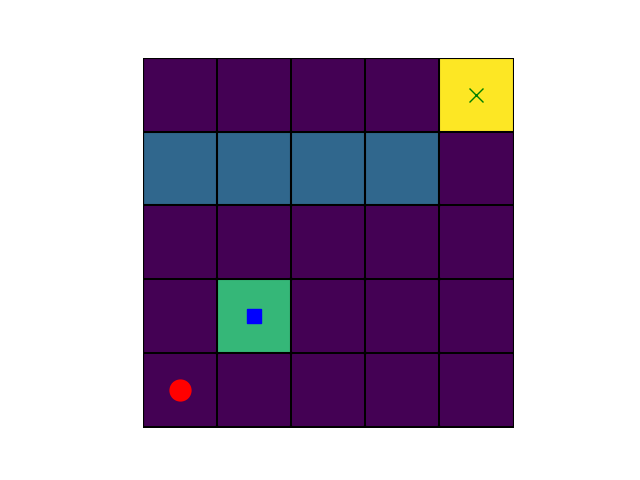

GIF saved at: gifs/medium_map1_ida.gif


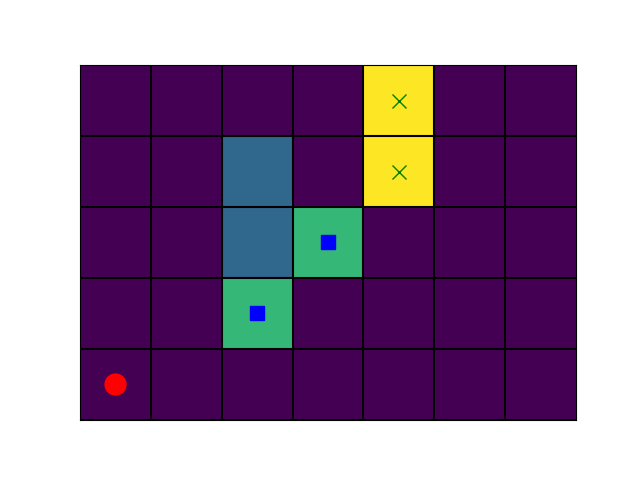

GIF saved at: gifs/medium_map2_ida.gif


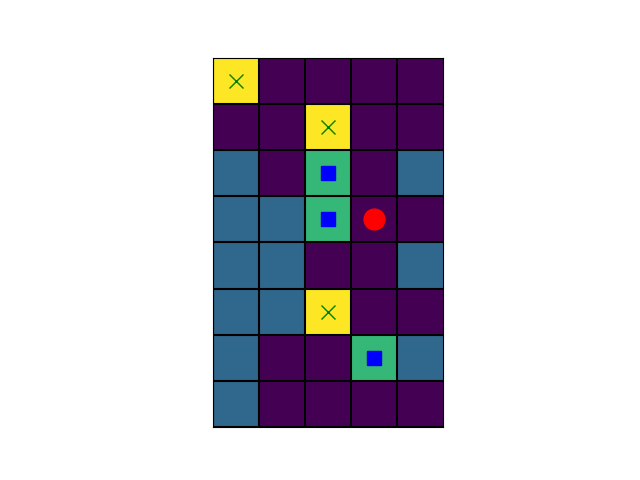

GIF saved at: gifs/large_map1_ida.gif


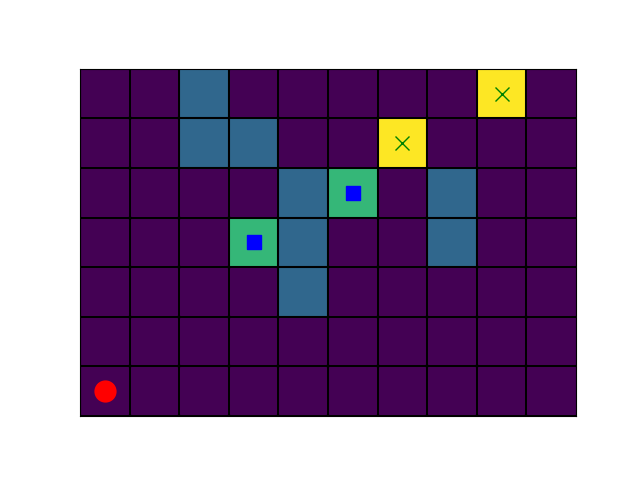

GIF saved at: gifs/large_map2_ida.gif


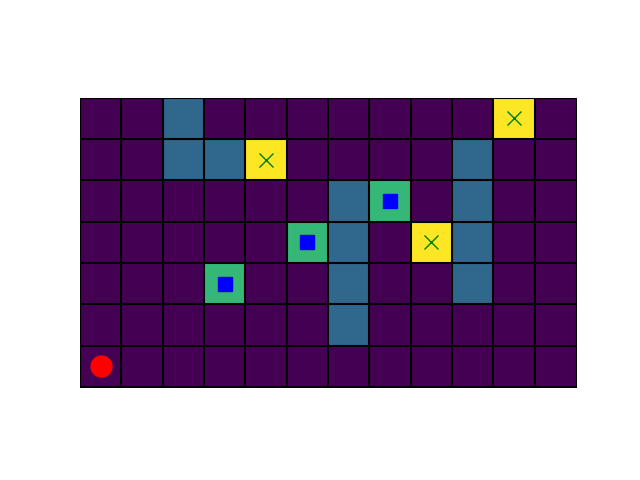

GIF saved at: gifs/hard_map1_ida.gif


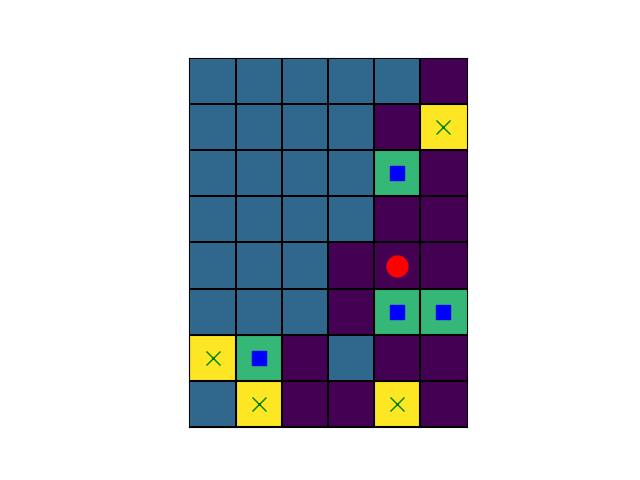

GIF saved at: gifs/hard_map2_ida.gif


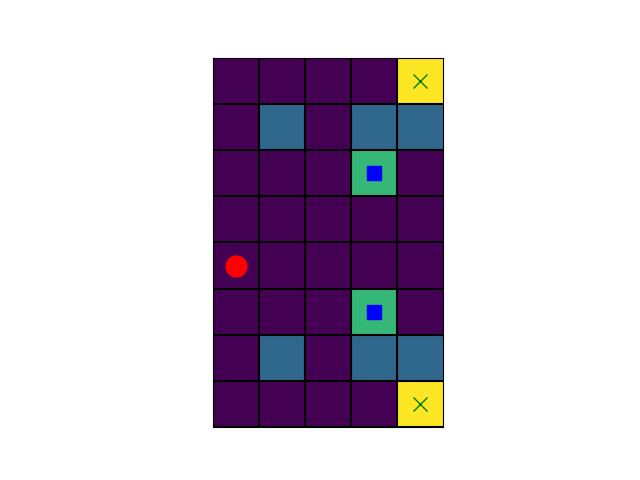

GIF saved at: gifs/super_hard_map1_ida.gif


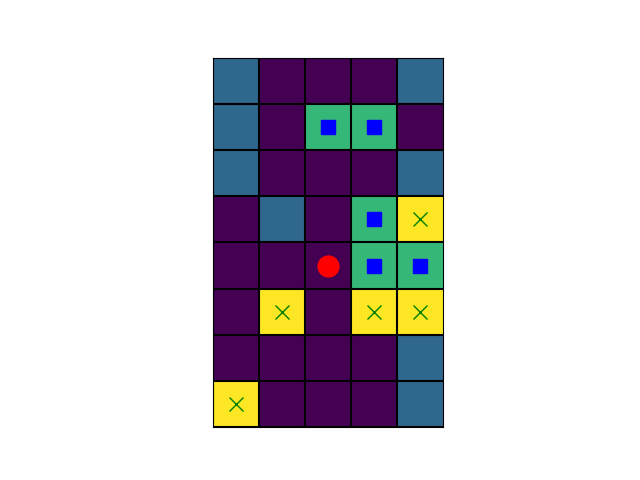

In [16]:
def generate_solution_steps(map_obj, solution):
    steps = []
    temp_map = map_obj.copy()
    steps.append(temp_map.copy())
    for move in solution or []:
        temp_map.apply_move(move)
        steps.append(temp_map.copy())
    return steps

output_dir = "gifs"
os.makedirs(output_dir, exist_ok=True)

for map_path in test_maps:
    map_name = map_path.split('/')[-1].replace('.yaml', '')
    m = Map.from_yaml(map_path)
    ida_solution = ida_star(m, ponderated_manhattan_heuristic)
    ida_steps = generate_solution_steps(m, ida_solution)
    save_images(ida_steps, f"{output_dir}/{map_name}_ida_steps")
    create_gif(f"{output_dir}/{map_name}_ida_steps", f"{map_name}_ida.gif", output_dir)
    display(Image(filename=f"{output_dir}/{map_name}_ida.gif"))

### 2. Simulated Annealing

GIF saved at: gifs/easy_map1_sa.gif


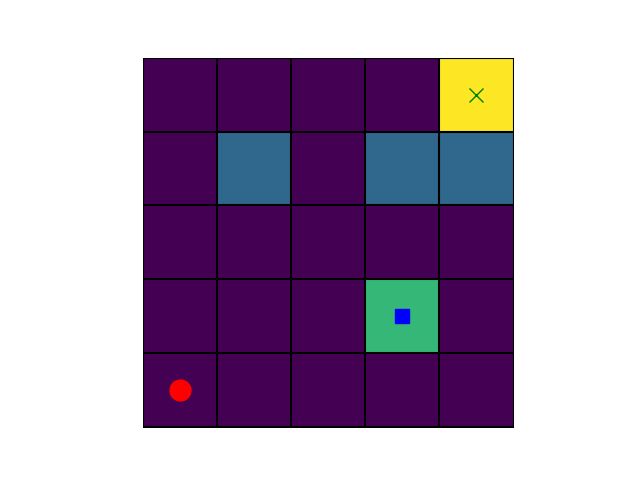

GIF saved at: gifs/easy_map2_sa.gif


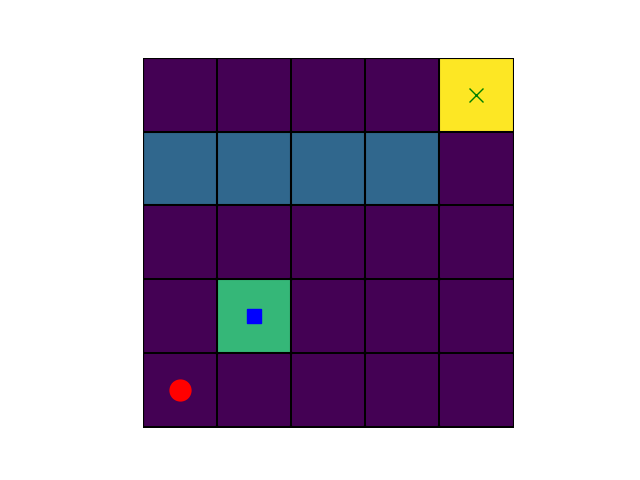

GIF saved at: gifs/medium_map1_sa.gif


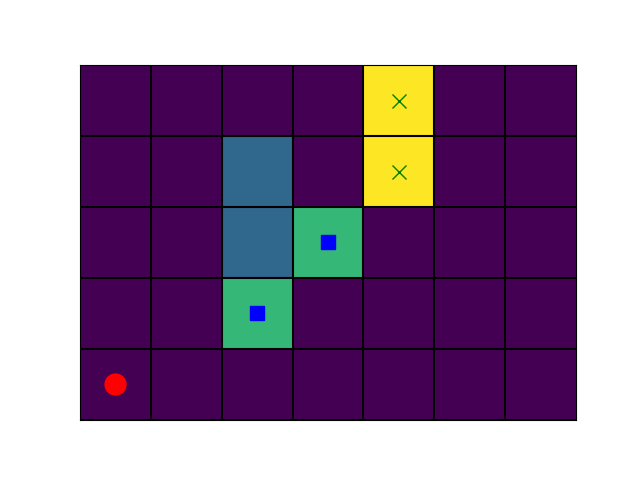

GIF saved at: gifs/medium_map2_sa.gif


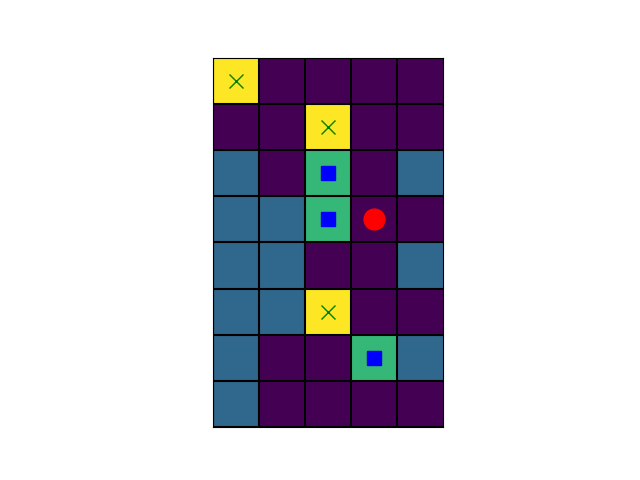

GIF saved at: gifs/large_map1_sa.gif


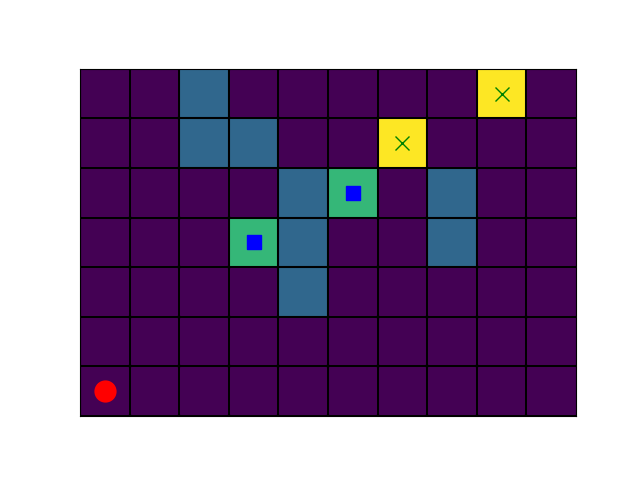

GIF saved at: gifs/large_map2_sa.gif


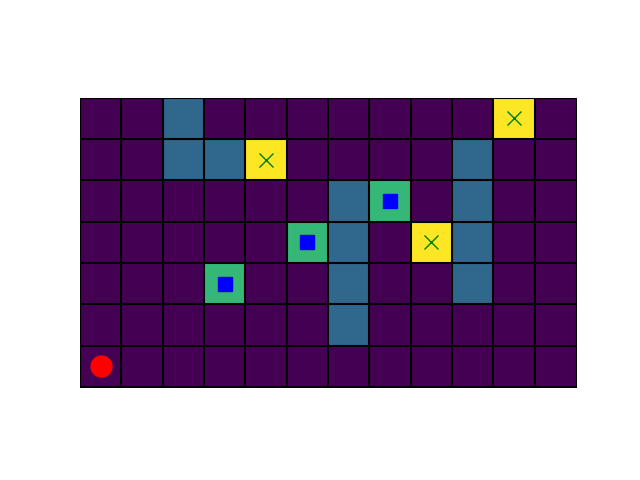

GIF saved at: gifs/hard_map1_sa.gif


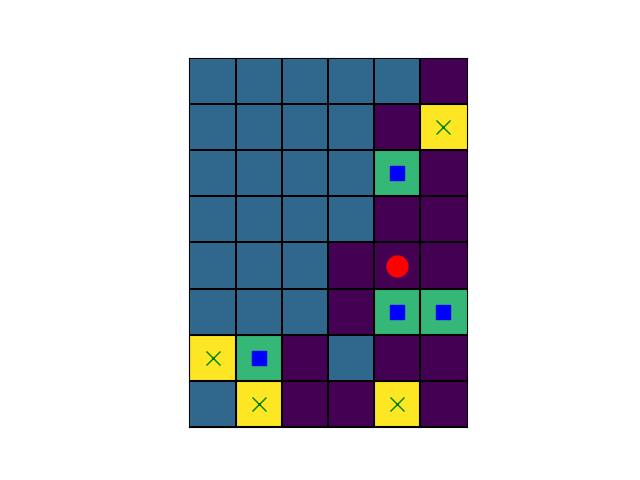

GIF saved at: gifs/hard_map2_sa.gif


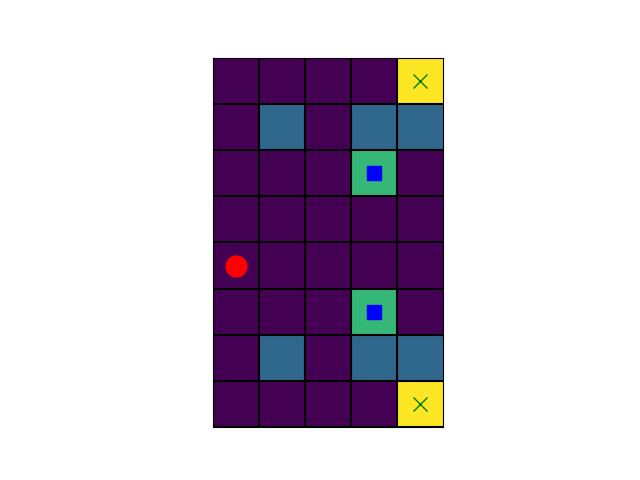

GIF saved at: gifs/super_hard_map1_sa.gif


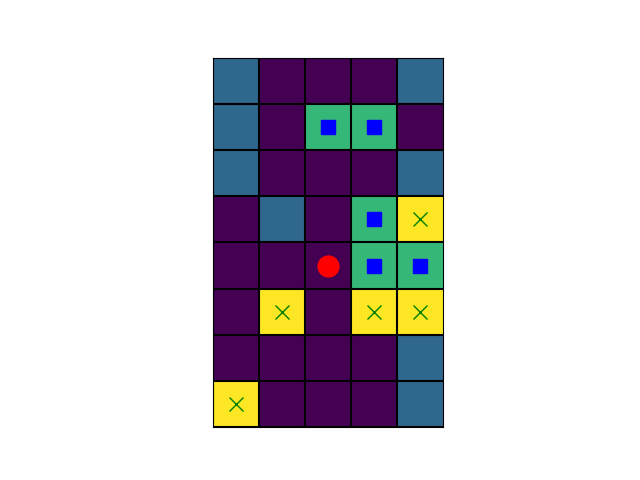

In [17]:
for map_path in test_maps:
    map_name = map_path.split('/')[-1].replace('.yaml', '')
    m = Map.from_yaml(map_path)
    sa_solution = simulated_annealing(m, ponderated_manhattan_heuristic)
    sa_steps = generate_solution_steps(m, sa_solution)
    save_images(sa_steps, f"{output_dir}/{map_name}_sa_steps")
    create_gif(f"{output_dir}/{map_name}_sa_steps", f"{map_name}_sa.gif", output_dir)
    display(Image(filename=f"{output_dir}/{map_name}_sa.gif"))